## Preparación del ambiente

In [2]:
import pandas as pd
import numpy as np
import csv
import pandas_profiling as pp

## Análisis de la muestra de datos de PAYMENTCONTROLDATA

1. Todos los registros (99) corresponden a transacciones con estado (_STATUS_) 'DELETED'
2. Con la información del mapeo se identifican 30 campos de interés de los 249 campos de la tabla
3. 17 campos de interés (57%) tienen valores constantes en la muestra (detalle más adelante)
2. Validar contenido de 4 campos de interés que: o tienen tipo no soportado o no tienen valores en la muestra (detalle más adelante)
2. _INSTRUCTIONID_ tiene un único valor en la muestra. _PAYMENTID_ tiene 99 valores distintos, por tanto, tiene más sentido que ***PAYMENTID*** sea el identificador único de la Trx
1. _PAYMENTTYPE_ en la muestra tiene 2 valores: 32 - Transacción Crédito Ahorros (98 ocurrencias) y 22 - Transacción Crédito Corriente (1 ocurrencia)



### Campos con valores constantes
INSTRUCTIONID has constant value "103523"	Constant  
SETTLEMENTREFERENCE has constant value "20220705-1"	Constant  
TRA_PHONE has constant value "29258945"	Constant  
D_PARTYID has constant value "BANCITIBAN"	Constant  
PIA_NAME has constant value "CITIBANK "	Constant  
RECEIVEDDATE has constant value "05-JUL-22 09.50.25.721000000 PM"	Constant  
VALUEDATE has constant value "05-JUL-22"	Constant  
IDRA_ADDRESS has constant value "V "	Constant  
BATCHID has constant value "6"	Constant  
STATUS has constant value "DELETED"	Constant  
D_NAME has constant value "UBER BV "	Constant  
IA1_NAME has constant value "6"	Constant  
IRA_EMAIL has constant value "86492016"	Constant  
ORIGINALSERVICELEVEL has constant value "PPD"	Constant  
IDRA_EMAIL has constant value "20220705"	Constant  
ORIGINALVALUEDATE has constant value "05-JUL-22"	Constant  
UNSTRUCTUREDPAYMENTINFO has constant value "000004444449824 TRASLADOS 000000000000000000000000 000000000000000000000000 "	Constant  

### Campos vacíos
ORIGMSGSUBFUNCTION has 99 (100.0%) missing values	Missing  
UC_PHONE has 99 (100.0%) missing values	Missing  
UC_NAME has 99 (100.0%) missing values	Missing  
UNIQUEMANDATEREFERENCE has 99 (100.0%) missing values	Missing  

ORIGMSGSUBFUNCTION is an unsupported type, check if it needs cleaning or further analysis	Unsupported  
UC_PHONE is an unsupported type, check if it needs cleaning or further analysis	Unsupported  
UC_NAME is an unsupported type, check if it needs cleaning or further analysis	Unsupported  
UNIQUEMANDATEREFERENCE is an unsupported type, check if it needs cleaning or further analysis	Unsupported  


### Consulta con los campos identificados
>`SELECT instructionid, PAYMENTID, originalpaymentreference, paymentType, settlementreference, TRA_PHONE, ca_clearingschemeid, c_account,
amount, D_PARTYID, c_clearingschemeid, c_name, pia_name, receiveddate, valuedate, IDRA_ADDRESS, origmsgsubfunction,
batchid, status, D_NAME, IA1_NAME, ira_email, originalservicelevel, IDRA_EMAIL, originalvaluedate, UC_PHONE,
SUBSTR(unstructuredpaymentinfo, 24, 8) as EFA, UC_NAME, UNIQUEMANDATEREFERENCE, C_ACCOUNTTYPE
FROM "dev_source_hubpagos"."paymentcontroldata"`

To Do:

[x] Incluir en el análisis el campo `TASKSTATUS`. Es tipo JSON y tiene información adicional y cambiante   
[x] Validar campos que o tienen tipo no soportado o no tienen valores en la muestra   
[x] Comparar contenido de campos sobre los que hay duda en el mapeo   

### Crear archivo copia para poderlo abrir en excel

Remover los saltos de línea en los campos json

In [27]:
raw_file = 'paymentcontroldata - copia.csv'
base_dir = '../data/hp/'
file = 'pcd.csv'

In [28]:
raw = []
with open(base_dir+raw_file) as f:
    r = csv.reader(f, quotechar='"', delimiter='|')
    for row in r:
        raw.append( [x.replace("\n"," ") for x in row] )

with open(base_dir+file, "w", newline="") as f:
    w = csv.writer(f, quotechar='"', quoting=csv.QUOTE_ALL)
    w.writerows(raw)


In [29]:
raw = pd.read_csv(base_dir+raw_file, delimiter='|')
raw.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99 entries, 0 to 98
Columns: 249 entries, OFFICECODE to CHARGEDETAILS
dtypes: float64(179), int64(39), object(31)
memory usage: 192.7+ KB


### Profiling

In [30]:
pcd = raw[['INSTRUCTIONID','PAYMENTID','ORIGINALPAYMENTREFERENCE','PAYMENTTYPE','SETTLEMENTREFERENCE','TRA_PHONE','CA_CLEARINGSCHEMEID','C_ACCOUNT',\
    'AMOUNT','D_PARTYID','C_CLEARINGSCHEMEID','C_NAME','PIA_NAME','RECEIVEDDATE','VALUEDATE','IDRA_ADDRESS','ORIGMSGSUBFUNCTION',\
    'BATCHID','STATUS','D_NAME','IA1_NAME','IRA_EMAIL','ORIGINALSERVICELEVEL','IDRA_EMAIL','ORIGINALVALUEDATE','UC_PHONE',\
    'UNSTRUCTUREDPAYMENTINFO','UC_NAME','UNIQUEMANDATEREFERENCE','C_ACCOUNTTYPE','TASKSTATUS']]

In [31]:
pp.ProfileReport(pcd)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [130]:
pcd.head().T

,0,1,2,3,4
INSTRUCTIONID,103523,103523,103523,103523,103523
PAYMENTID,be4e21db-01aa-4cf3-801d-ebd2bccb1a6c,5056d8f7-37c4-4414-b291-2c3c7c62210a,d0c71a3e-2a95-45e3-85c7-7e40ebb7cfc2,907cf48b-9621-46f8-af25-78d067de9d83,8dab9e8a-2826-4b61-a86b-13c1cff6ad1c
ORIGINALPAYMENTREFERENCE,10095089514,10095089515,10095089516,10095089517,10095089528
PAYMENTTYPE,32,32,32,32,32
SETTLEMENTREFERENCE,20220705-1,20220705-1,20220705-1,20220705-1,20220705-1
TRA_PHONE,29258945,29258945,29258945,29258945,29258945
CA_CLEARINGSCHEMEID,1052,1013,1032,1007,1051
C_ACCOUNT,615719130,21273933,24114139788,6087585881,550488404059104
AMOUNT,88661,6700,62532,15955,660521
D_PARTYID,BANCITIBAN,BANCITIBAN,BANCITIBAN,BANCITIBAN,BANCITIBAN


In [131]:
pcd.describe()

,INSTRUCTIONID,ORIGINALPAYMENTREFERENCE,PAYMENTTYPE,TRA_PHONE,CA_CLEARINGSCHEMEID,C_ACCOUNT,AMOUNT,C_CLEARINGSCHEMEID,ORIGMSGSUBFUNCTION,BATCHID,IA1_NAME,IRA_EMAIL,IDRA_EMAIL,UC_PHONE,UC_NAME,UNIQUEMANDATEREFERENCE,C_ACCOUNTTYPE
count,99.0,9.900000e+01,99.000000,99.0,99.000000,9.900000e+01,9.900000e+01,9.900000e+01,0.0,99.0,99.0,99.0,99.0,0.0,0.0,0.0,99.000000
mean,103523.0,1.009509e+10,31.898990,29258945.0,1019.565657,1.118734e+13,2.059243e+05,4.927753e+08,NaN,6.0,6.0,86492016.0,20220705.0,NaN,NaN,NaN,31.898990
std,0.0,2.877740e+02,1.005038,0.0,18.900471,7.783331e+13,2.508078e+05,4.968647e+08,NaN,0.0,0.0,0.0,0.0,NaN,NaN,NaN,1.005038
min,103523.0,1.009509e+10,22.000000,29258945.0,1001.000000,1.505476e+07,1.570000e+03,4.192940e+06,NaN,6.0,6.0,86492016.0,20220705.0,NaN,NaN,NaN,22.000000
25%,103523.0,1.009509e+10,32.000000,29258945.0,1007.000000,3.863257e+09,3.753800e+04,7.161759e+07,NaN,6.0,6.0,86492016.0,20220705.0,NaN,NaN,NaN,32.000000
50%,103523.0,1.009509e+10,32.000000,29258945.0,1007.000000,2.407921e+10,9.127500e+04,8.607752e+07,NaN,6.0,6.0,86492016.0,20220705.0,NaN,NaN,NaN,32.000000
75%,103523.0,1.009509e+10,32.000000,29258945.0,1032.000000,6.836872e+10,2.911935e+05,1.023488e+09,NaN,6.0,6.0,86492016.0,20220705.0,NaN,NaN,NaN,32.000000
max,103523.0,1.009509e+10,32.000000,29258945.0,1062.000000,5.504884e+14,1.345471e+06,1.216720e+09,NaN,6.0,6.0,86492016.0,20220705.0,NaN,NaN,NaN,32.000000


In [132]:
include_list=['object']
pcd.describe(include=include_list)

,PAYMENTID,SETTLEMENTREFERENCE,D_PARTYID,C_NAME,PIA_NAME,RECEIVEDDATE,VALUEDATE,IDRA_ADDRESS,STATUS,D_NAME,ORIGINALSERVICELEVEL,ORIGINALVALUEDATE,UNSTRUCTUREDPAYMENTINFO
count,99,99,99,99,99,99,99,99,99,99,99,99,99
unique,99,1,1,99,1,1,1,1,1,1,1,1,1
top,be4e21db-01aa-4cf3-801d-ebd2bccb1a6c,20220705-1,BANCITIBAN,ANDRES FELIPE RODRIGUE,CITIBANK,05-JUL-22 09.50.25.721000000 PM,05-JUL-22,V,DELETED,UBER BV,PPD,05-JUL-22,000004444449824 TRASLADOS 0000000000000000000...
freq,1,99,99,1,99,99,99,99,99,99,99,99,99


In [7]:
pcd.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99 entries, 0 to 98
Data columns (total 31 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   INSTRUCTIONID             99 non-null     int64  
 1   PAYMENTID                 99 non-null     object 
 2   ORIGINALPAYMENTREFERENCE  99 non-null     int64  
 3   PAYMENTTYPE               99 non-null     int64  
 4   SETTLEMENTREFERENCE       99 non-null     object 
 5   TRA_PHONE                 99 non-null     int64  
 6   CA_CLEARINGSCHEMEID       99 non-null     int64  
 7   C_ACCOUNT                 99 non-null     int64  
 8   AMOUNT                    99 non-null     int64  
 9   D_PARTYID                 99 non-null     object 
 10  C_CLEARINGSCHEMEID        99 non-null     int64  
 11  C_NAME                    99 non-null     object 
 12  PIA_NAME                  99 non-null     object 
 13  RECEIVEDDATE              99 non-null     object 
 14  VALUEDATE   

### Todos los registros corresponden a transacciones con estado (**`STATUS`**) 'DELETED'

In [119]:
pcd.STATUS.unique()

array(['DELETED'], dtype=object)

In [120]:
pcd['STATUS'].value_counts()

DELETED    99
Name: STATUS, dtype: int64

In [121]:
pcd.head(3).T

,0,1,2
INSTRUCTIONID,103523,103523,103523
PAYMENTID,be4e21db-01aa-4cf3-801d-ebd2bccb1a6c,5056d8f7-37c4-4414-b291-2c3c7c62210a,d0c71a3e-2a95-45e3-85c7-7e40ebb7cfc2
ORIGINALPAYMENTREFERENCE,10095089514,10095089515,10095089516
PAYMENTTYPE,32,32,32
SETTLEMENTREFERENCE,20220705-1,20220705-1,20220705-1
TRA_PHONE,29258945,29258945,29258945
CA_CLEARINGSCHEMEID,1052,1013,1032
C_ACCOUNT,615719130,21273933,24114139788
AMOUNT,88661,6700,62532
D_PARTYID,BANCITIBAN,BANCITIBAN,BANCITIBAN


### Validaciones con campo ```TASKSTATUS```

Hay dos valores cambiantes en el JSON.   
1. El "NUMERO DE SECUENCIA DE TRANSACCION DEL REGISTRO DE DETALLE DE TRANSACCIONES" cuyo valor se repite en el campo UD_ACCOUNTTYPE y está contenido en el campo ORIGINALPAYMENTREFERENCE
2. El valor "recordDelim", el cual no se encuentra en ningún otro campo del registro

In [20]:
pcd['TASKSTATUS'].loc[1]

'{     "AdendaCredito":[         {             "TIPO DE REGISTRO":"7",             "CODIGO TIPO DE REGISTRO ADENDA":"05",             "IDENTIFICACION CLIENTE ORIGINADOR":"000004444449824",             "RESERVADO":"  ",             "PROPOSITO DE LA TRANSACCION":"TRASLADOS ",             "REFERENCIA DEL PAGO":"000000000000000000000000  000000000000000000000000   ",             "NUMERO DE SECUENCIA DE REGISTRO DE ADENDA":"0001",             "NUMERO DE SECUENCIA DE TRANSACCION DEL REGISTRO DE DETALLE DE TRANSACCIONES":"5089515",             "FILLER8":"            ",             "recordDelim":"1564"         }     ] }'

In [21]:
pcd['TASKSTATUS'].loc[2]

'{     "AdendaCredito":[         {             "TIPO DE REGISTRO":"7",             "CODIGO TIPO DE REGISTRO ADENDA":"05",             "IDENTIFICACION CLIENTE ORIGINADOR":"000004444449824",             "RESERVADO":"  ",             "PROPOSITO DE LA TRANSACCION":"TRASLADOS ",             "REFERENCIA DEL PAGO":"000000000000000000000000  000000000000000000000000   ",             "NUMERO DE SECUENCIA DE REGISTRO DE ADENDA":"0001",             "NUMERO DE SECUENCIA DE TRANSACCION DEL REGISTRO DE DETALLE DE TRANSACCIONES":"5089516",             "FILLER8":"            ",             "recordDelim":"1566"         }     ] }'

In [22]:
pcd['TASKSTATUS'].loc[3]

'{     "AdendaCredito":[         {             "TIPO DE REGISTRO":"7",             "CODIGO TIPO DE REGISTRO ADENDA":"05",             "IDENTIFICACION CLIENTE ORIGINADOR":"000004444449824",             "RESERVADO":"  ",             "PROPOSITO DE LA TRANSACCION":"TRASLADOS ",             "REFERENCIA DEL PAGO":"000000000000000000000000  000000000000000000000000   ",             "NUMERO DE SECUENCIA DE REGISTRO DE ADENDA":"0001",             "NUMERO DE SECUENCIA DE TRANSACCION DEL REGISTRO DE DETALLE DE TRANSACCIONES":"5089517",             "FILLER8":"            ",             "recordDelim":"1568"         }     ] }'

### Validaciones con AMOUNT, C_ACCOUNT, RECEIVEDDATE - VALUEDATE

In [32]:
pcd['AMOUNT'].value_counts()

88661     1
91275     1
78745     1
5473      1
837969    1
         ..
445776    1
322992    1
27258     1
15706     1
126700    1
Name: AMOUNT, Length: 99, dtype: int64

In [33]:
pcd['C_ACCOUNT'].value_counts()

615719130       1
1860011459      1
24079207012     1
648619062       1
488405535417    1
               ..
3024282251      1
48612437141     1
24111408409     1
49253017910     1
144371648       1
Name: C_ACCOUNT, Length: 99, dtype: int64

In [36]:
pcd[(pcd.RECEIVEDDATE != pcd.VALUEDATE)].count()

INSTRUCTIONID               99
PAYMENTID                   99
ORIGINALPAYMENTREFERENCE    99
PAYMENTTYPE                 99
SETTLEMENTREFERENCE         99
TRA_PHONE                   99
CA_CLEARINGSCHEMEID         99
C_ACCOUNT                   99
AMOUNT                      99
D_PARTYID                   99
C_CLEARINGSCHEMEID          99
C_NAME                      99
PIA_NAME                    99
RECEIVEDDATE                99
VALUEDATE                   99
IDRA_ADDRESS                99
ORIGMSGSUBFUNCTION           0
BATCHID                     99
STATUS                      99
D_NAME                      99
IA1_NAME                    99
IRA_EMAIL                   99
ORIGINALSERVICELEVEL        99
IDRA_EMAIL                  99
ORIGINALVALUEDATE           99
UC_PHONE                     0
UNSTRUCTUREDPAYMENTINFO     99
UC_NAME                      0
UNIQUEMANDATEREFERENCE       0
C_ACCOUNTTYPE               99
TASKSTATUS                  99
dtype: int64

In [37]:
pcd[['RECEIVEDDATE','VALUEDATE']]

,RECEIVEDDATE,VALUEDATE
0,05-JUL-22 09.50.25.721000000 PM,05-JUL-22
1,05-JUL-22 09.50.25.721000000 PM,05-JUL-22
2,05-JUL-22 09.50.25.721000000 PM,05-JUL-22
3,05-JUL-22 09.50.25.721000000 PM,05-JUL-22
4,05-JUL-22 09.50.25.721000000 PM,05-JUL-22
...,...,...
94,05-JUL-22 09.50.25.721000000 PM,05-JUL-22
95,05-JUL-22 09.50.25.721000000 PM,05-JUL-22
96,05-JUL-22 09.50.25.721000000 PM,05-JUL-22
97,05-JUL-22 09.50.25.721000000 PM,05-JUL-22


## Análisis de la muestra de datos de INSTRUCTIONRAWDATA

### Crear archivo copia para poder abrirlo en excel
Remover los saltos de línea en los campos json

In [1]:
raw_file = 'instructionrawdata.csv'
base_dir = '../data/hp/'
file = 'ird.csv'

In [4]:
raw = []
with open(base_dir+raw_file) as f:
    r = csv.reader(f, quotechar='"', delimiter='|')
    for row in r:
        raw.append( [x.replace("\n"," ") for x in row] )

with open(base_dir+file, "w", newline="") as f:
    w = csv.writer(f, quotechar='"', quoting=csv.QUOTE_ALL)
    w.writerows(raw)

In [5]:
raw = pd.read_csv(base_dir+raw_file, delimiter='|')
raw.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99 entries, 0 to 98
Data columns (total 61 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   INSTRUCTIONID                   99 non-null     int64  
 1   ENTRYDATE                       99 non-null     object 
 2   FILESTATUS                      99 non-null     object 
 3   TOTAL_NUMBER_OF_PAYMENTS        98 non-null     float64
 4   PAYMENTSCOMPLETED               98 non-null     float64
 5   PAYMENTSREJECTED                98 non-null     float64
 6   PAYMENTSPENDING                 98 non-null     float64
 7   FILEPROCESSINGSERVER            99 non-null     object 
 8   FILEHASH                        0 non-null      float64
 9   FIELDHASH                       0 non-null      float64
 10  DESCRIPTION                     98 non-null     object 
 11  OPTIMIZEDSTORAGE                98 non-null     float64
 12  ISDATACOMPUTATION               0 non-

### Profiling

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

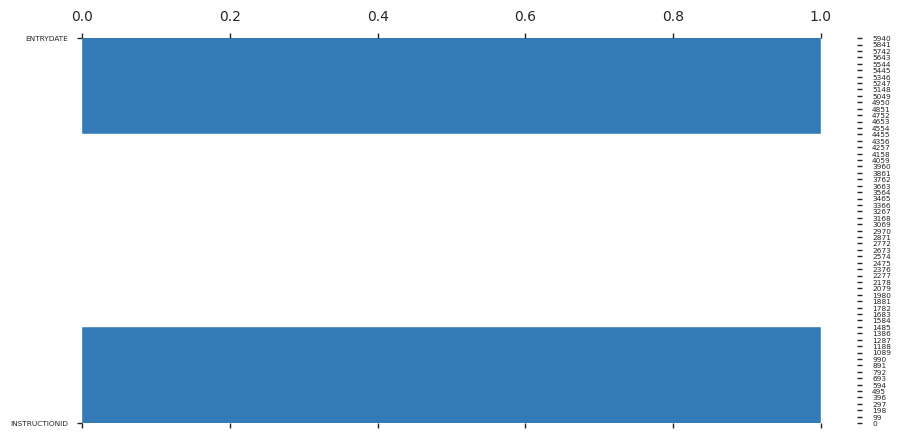

In [8]:
pp.ProfileReport(raw)

In [12]:
ird = raw[['ENTRYDATE', 'TRANSPORTNAME', 'ORIGINAL_FINANCIAL_ENTITY_NAME', 'TOTAL_NUMBER_OF_PAYMENTS', 'PAYMENTSCOMPLETED', 'PAYMENTSREJECTED', \
     'DEBIT_VALUE', 'CREDIT_VALUE', 'INSTRUCTIONID', 'FILESTATUS']]

In [13]:
pp.ProfileReport(ird)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [19]:
ird[['FILESTATUS']].value_counts()

FILESTATUS
REJECTED      53
COMPLETED     45
DELETED        1
dtype: int64

In [18]:
ird[(ird.FILESTATUS != 'REJECTED')].head(5).T

,14,18,19,23,31
ENTRYDATE,05-JUL-22 11.54.29.337000000 PM,06-JUL-22 12.34.55.348000000 AM,06-JUL-22 12.56.02.268000000 AM,06-JUL-22 12.59.40.940000000 AM,06-JUL-22 03.23.07.185000000 PM
TRANSPORTNAME,0001009.002.1.env,0001009.001.1.env,0001007.028.1.env,0001001.002.1.env,0001001.001.1.env
ORIGINAL_FINANCIAL_ENTITY_NAME,CITIBANK,CITIBANK,BANCOLOMBIA,BOGOTA,BOGOTA
TOTAL_NUMBER_OF_PAYMENTS,1980.0,88492.0,159357.0,48609.0,1702.0
PAYMENTSCOMPLETED,591.0,88484.0,159350.0,48607.0,1702.0
PAYMENTSREJECTED,1389.0,8.0,7.0,2.0,0.0
DEBIT_VALUE,0.0,0.0,11619742430.01,154279715.32,274710254.0
CREDIT_VALUE,6265055805.16,152670847709.459991,675253139438.180054,274050445600.48999,902622042.13
INSTRUCTIONID,104221,104222,104561,104562,106602
FILESTATUS,COMPLETED,COMPLETED,COMPLETED,COMPLETED,COMPLETED
